### Initialization Bock

In [1]:
# Initialization
colab_run=False
anc_box= False
train=True
if colab_run==True:
  !pip install pydrive
  from pydrive.auth import GoogleAuth
  from pydrive.drive import GoogleDrive
  from google.colab import auth
  from oauth2client.client import GoogleCredentials

  auth.authenticate_user()
  gauth = GoogleAuth()
  gauth.credentials = GoogleCredentials.get_application_default()
  drive = GoogleDrive(gauth)

  import os, cv2
  from google.colab import drive
  drive.mount('/content/drive/')


from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Reshape, Activation, Conv2D, Input, MaxPooling2D, BatchNormalization, Flatten, Dense, Lambda
from tensorflow.keras.layers import LeakyReLU
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, TensorBoard
from tensorflow.keras.optimizers import SGD, Adam, RMSprop
from tensorflow.keras.layers import concatenate
from matplotlib import pyplot as plt
import tensorflow.keras.backend as K
import tensorflow as tf
import numpy as np
import pickle
import os, cv2

#os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
#os.environ["CUDA_VISIBLE_DEVICES"] = ""

# %matplotlib inline


C:\Users\irfan\Anaconda3\envs\tf\lib\site-packages\tensorflow\python\framework\dtypes.py:523: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
C:\Users\irfan\Anaconda3\envs\tf\lib\site-packages\tensorflow\python\framework\dtypes.py:524: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
C:\Users\irfan\Anaconda3\envs\tf\lib\site-packages\tensorflow\python\framework\dtypes.py:525: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
C:\Users\irfan\Anaconda3\envs\tf\lib\site-packages\tensorflow\python\framework\dty

### Configure Block

### Model Building Block

In [2]:
LABELS=['person', 'bird', 'cat', 'cow', 'dog', 'horse', 'sheep','aeroplane', 'bicycle',
         'boat', 'bus', 'car', 'motorbike', 'train', 'bottle', 'chair','dining table',
         'potted plant', 'sofa', 'tvmonitor']

IMAGE_H, IMAGE_W = 416, 416
GRID_H,  GRID_W  = 13 , 13 
BOX              = 5
CLASS            = len(LABELS)
CLASS_WEIGHTS    = np.ones(CLASS, dtype='float32')
OBJ_THRESHOLD    = 0.3#0.5
NMS_THRESHOLD    = 0.3#0.45
#ANCHORS          = [0.57273, 0.677385, 1.87446, 2.06253, 3.33843, 5.47434, 7.88282, 3.52778, 9.77052, 9.16828]
ANCHORS          = [ 4.469053,2.148582,10.548851,5.381520,11.420664,9.961033,6.517299,3.699693,2.469196,1.599054]
#ANCHORS=[13,13]
NO_OBJECT_SCALE  = 1.0
OBJECT_SCALE     = 5.0
COORD_SCALE      = 1.0
CLASS_SCALE      = 1.0

batch_size       = 10
WARM_UP_BATCHES  = 0
TRUE_BOX_BUFFER  = 50


In [3]:
# the function to implement the orgnization layer (thanks to github.com/allanzelener/YAD2K)
def space_to_depth_x2(x):
    return tf.space_to_depth(x, block_size=2)

def build_model():
  input_image = Input(shape=(IMAGE_H, IMAGE_W, 3))
  true_boxes  = Input(shape=(1, 1, 1, TRUE_BOX_BUFFER , 4))

  # Layer 1
  x = Conv2D(32, (3,3), strides=(1,1), padding='same', name='conv_1', use_bias=False)(input_image)
  x = BatchNormalization(name='norm_1')(x)
  x = LeakyReLU(alpha=0.1)(x)
  x = MaxPooling2D(pool_size=(2, 2))(x)

  # Layer 2
  x = Conv2D(64, (3,3), strides=(1,1), padding='same', name='conv_2', use_bias=False)(x)
  x = BatchNormalization(name='norm_2')(x)
  x = LeakyReLU(alpha=0.1)(x)
  x = MaxPooling2D(pool_size=(2, 2))(x)

  # Layer 3
  x = Conv2D(128, (3,3), strides=(1,1), padding='same', name='conv_3', use_bias=False)(x)
  x = BatchNormalization(name='norm_3')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 4
  x = Conv2D(64, (1,1), strides=(1,1), padding='same', name='conv_4', use_bias=False)(x)
  x = BatchNormalization(name='norm_4')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 5
  x = Conv2D(128, (3,3), strides=(1,1), padding='same', name='conv_5', use_bias=False)(x)
  x = BatchNormalization(name='norm_5')(x)
  x = LeakyReLU(alpha=0.1)(x)
  x = MaxPooling2D(pool_size=(2, 2))(x)

  # Layer 6
  x = Conv2D(256, (3,3), strides=(1,1), padding='same', name='conv_6', use_bias=False)(x)
  x = BatchNormalization(name='norm_6')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 7
  x = Conv2D(128, (1,1), strides=(1,1), padding='same', name='conv_7', use_bias=False)(x)
  x = BatchNormalization(name='norm_7')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 8
  x = Conv2D(256, (3,3), strides=(1,1), padding='same', name='conv_8', use_bias=False)(x)
  x = BatchNormalization(name='norm_8')(x)
  x = LeakyReLU(alpha=0.1)(x)
  x = MaxPooling2D(pool_size=(2, 2))(x)

  # Layer 9
  x = Conv2D(512, (3,3), strides=(1,1), padding='same', name='conv_9', use_bias=False)(x)
  x = BatchNormalization(name='norm_9')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 10
  x = Conv2D(256, (1,1), strides=(1,1), padding='same', name='conv_10', use_bias=False)(x)
  x = BatchNormalization(name='norm_10')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 11
  x = Conv2D(512, (3,3), strides=(1,1), padding='same', name='conv_11', use_bias=False)(x)
  x = BatchNormalization(name='norm_11')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 12
  x = Conv2D(256, (1,1), strides=(1,1), padding='same', name='conv_12', use_bias=False)(x)
  x = BatchNormalization(name='norm_12')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 13
  x = Conv2D(512, (3,3), strides=(1,1), padding='same', name='conv_13', use_bias=False)(x)
  x = BatchNormalization(name='norm_13')(x)
  x = LeakyReLU(alpha=0.1)(x)

  skip_connection = x

  x = MaxPooling2D(pool_size=(2, 2))(x)

  # Layer 14
  x = Conv2D(1024, (3,3), strides=(1,1), padding='same', name='conv_14', use_bias=False)(x)
  x = BatchNormalization(name='norm_14')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 15
  x = Conv2D(512, (1,1), strides=(1,1), padding='same', name='conv_15', use_bias=False)(x)
  x = BatchNormalization(name='norm_15')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 16
  x = Conv2D(1024, (3,3), strides=(1,1), padding='same', name='conv_16', use_bias=False)(x)
  x = BatchNormalization(name='norm_16')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 17
  x = Conv2D(512, (1,1), strides=(1,1), padding='same', name='conv_17', use_bias=False)(x)
  x = BatchNormalization(name='norm_17')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 18
  x = Conv2D(1024, (3,3), strides=(1,1), padding='same', name='conv_18', use_bias=False)(x)
  x = BatchNormalization(name='norm_18')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 19
  x = Conv2D(1024, (3,3), strides=(1,1), padding='same', name='conv_19', use_bias=False)(x)
  x = BatchNormalization(name='norm_19')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 20
  x = Conv2D(1024, (3,3), strides=(1,1), padding='same', name='conv_20', use_bias=False)(x)
  x = BatchNormalization(name='norm_20')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 21
  skip_connection = Conv2D(64, (1,1), strides=(1,1), padding='same', name='conv_21', use_bias=False)(skip_connection)
  skip_connection = BatchNormalization(name='norm_21')(skip_connection)
  skip_connection = LeakyReLU(alpha=0.1)(skip_connection)
  skip_connection = Lambda(space_to_depth_x2)(skip_connection)

  x = concatenate([skip_connection, x])

  # Layer 22
  x = Conv2D(1024, (3,3), strides=(1,1), padding='same', name='conv_22', use_bias=False)(x)
  x = BatchNormalization(name='norm_22')(x)
  x = LeakyReLU(alpha=0.1)(x)

  if anc_box==True:
    # Layer 23
    x = Conv2D(BOX*(4 + 1 + CLASS), (1,1), strides=(1,1), padding='same', name='conv_23')(x)
    output = Reshape((GRID_H, GRID_W,BOX,4 + 1 + CLASS))(x)
  else :
    # Layer 23
    x = Conv2D((4 + 1 + CLASS), (1,1), strides=(1,1), padding='same', name='conv_23')(x)
    output = Reshape((GRID_H, GRID_W,4 + 1 + CLASS))(x)

  # small hack to allow true_boxes to be registered when Keras build the model 
  # for more information: https://github.com/fchollet/keras/issues/2790
  #output = Lambda(lambda args: args[0])([output, true_boxes])#Change :Hasib

  #model = Model([input_image, true_boxes], output)#Change :Hasib
  model = Model(input_image, output)
  return model
  #model.load_weights('/content/drive/My Drive/Data/yolo_net_ep500_act.h5')


class WeightReader:
    def __init__(self, weight_file):
        self.offset = 4
        self.all_weights = np.fromfile(weight_file, dtype='float32')
        
    def read_bytes(self, size):
        self.offset = self.offset + size
        return self.all_weights[self.offset-size:self.offset]
    
    def reset(self):
        self.offset = 4

def load_weights(model,path_wst):
  wt_path = path_wts                      
  weight_reader = WeightReader(wt_path)
  weight_reader.reset()
  nb_conv = 23

  for i in range(1, nb_conv+1):
      conv_layer = model.get_layer('conv_' + str(i))

      if i < nb_conv:
          norm_layer = model.get_layer('norm_' + str(i))

          size = np.prod(norm_layer.get_weights()[0].shape)

          beta  = weight_reader.read_bytes(size)
          gamma = weight_reader.read_bytes(size)
          mean  = weight_reader.read_bytes(size)
          var   = weight_reader.read_bytes(size)

          weights = norm_layer.set_weights([gamma, beta, mean, var])       

      if len(conv_layer.get_weights()) > 1:
          bias   = weight_reader.read_bytes(np.prod(conv_layer.get_weights()[1].shape))
          kernel = weight_reader.read_bytes(np.prod(conv_layer.get_weights()[0].shape))
          kernel = kernel.reshape(list(reversed(conv_layer.get_weights()[0].shape)))
          kernel = kernel.transpose([2,3,1,0])
          conv_layer.set_weights([kernel, bias])
      else:
          kernel = weight_reader.read_bytes(np.prod(conv_layer.get_weights()[0].shape))
          kernel = kernel.reshape(list(reversed(conv_layer.get_weights()[0].shape)))
          kernel = kernel.transpose([2,3,1,0])
          conv_layer.set_weights([kernel])
  return model


def yolo_loss_0(y_true, y_pred):
        loss=0
      #for n in range(BATCH_SIZE):
        for i in range(GRID_H):
          for j in range(GRID_W):
            for k in range(0,6):
              temp=y_true[i,j,k]-y_pred[i,j,k]
              #temp=temp**2
              loss+=temp
              
        return loss 
def yolo_loss_1(y_true, y_pred):
      loss=0
          ### adjust w and h
      ob_mask= tf.expand_dims(y_true[..., 4], axis=-1)
      conf_mask=y_true[...,4]
      
      if anc_box==True:
        cell_x = tf.to_float(tf.reshape(tf.tile(tf.range(GRID_W), [GRID_H]), (1, GRID_H, GRID_W, 1, 1)))
        cell_y = tf.transpose(cell_x, (0,2,1,3,4))
        cell_grid = tf.tile(tf.concat([cell_x,cell_y], -1), [BATCH_SIZE, 1, 1, 5, 1])

        pred_xy = tf.sigmoid(y_pred[..., :2]) + cell_grid
        pred_wh = tf.exp(y_pred[..., 2:4]) * np.reshape(ANCHORS, [1,1,1,BOX,2])
      
      else:
        pred_xy=(y_pred[...,0:2])
        pred_wh=(y_pred[...,2:4])
      
      true_xy=y_true[...,0:2]
      true_wh=y_true[...,2:4]
      
      #pred_wh=tf.multiply(pred_wh,ob_mask)
      pred_conf=y_pred[...,4]
      ### adjust confidence
      true_wh_half = true_wh / 2.
      true_mins    = tf.subtract(true_xy,true_wh_half)
      true_maxes   = tf.add(true_xy,true_wh_half)
    
      pred_wh_half = pred_wh / 2.
      pred_mins    = tf.subtract(pred_xy,pred_wh_half)
      pred_maxes   = tf.add(pred_xy,pred_wh_half)       
    
      intersect_mins  = tf.maximum(pred_mins,  true_mins)
      intersect_maxes = tf.minimum(pred_maxes, true_maxes)
      intersect_wh    = tf.maximum(intersect_maxes - intersect_mins, 0.)
      intersect_areas = tf.multiply(intersect_wh[..., 0] , intersect_wh[..., 1])
    
      true_areas = tf.multiply(true_wh[..., 0] , true_wh[..., 1])
      pred_areas = tf.multiply(pred_wh[..., 0] , pred_wh[..., 1])

      union_areas =tf.subtract(tf.add(pred_areas,true_areas),intersect_areas)
      intersect_areas=tf.add(intersect_areas,1)
      union_areas=tf.add(union_areas,1)
      iou_scores  = tf.truediv(intersect_areas, union_areas)
      true_box_class = tf.argmax(y_true[..., 5:], -1)
      pred_box_class=y_pred[..., 4]
      pred_box_class = y_pred[..., 5:]
      class_mask = y_true[..., 4] * tf.gather(CLASS_WEIGHTS, true_box_class)
    
      #class_mask = y_true[..., 4] * tf.to_float(true_box_class)
      nb_class_box = tf.reduce_sum(tf.to_float(class_mask > 0.0))
      true_conf =tf.multiply( iou_scores,y_true[..., 4])
      
      loss_bb=tf.subtract(true_xy,pred_xy)
      loss_bb=tf.square(loss_bb)
      loss_bb=tf.multiply(loss_bb,ob_mask)
      loss_bb=tf.reduce_sum(loss_bb)
      loss_wh=tf.subtract((true_wh),(pred_wh))
      loss_wh=tf.square(loss_wh)
      loss_wh=tf.multiply(loss_wh,ob_mask)
      loss_wh=tf.reduce_sum(loss_wh)
      loss_conf=tf.subtract(true_conf,pred_conf)
      loss_conf=tf.square(loss_conf)
      loss_conf=tf.multiply(loss_conf,conf_mask)
      loss_conf=tf.reduce_sum(loss_conf)
      loss_class = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=true_box_class, logits=pred_box_class)
      loss_class = tf.reduce_sum(loss_class * class_mask) / (nb_class_box + 1e-6)
      loss=loss_bb+loss_wh+loss_conf+loss_class       
      return loss


### Data Ready Block

In [4]:
def _interval_overlap(interval_a, interval_b):
    x1, x2 = interval_a
    x3, x4 = interval_b

    if x3 < x1:
        if x4 < x1:
            return 0
        else:
            return min(x2,x4) - x1
    else:
        if x2 < x3:
             return 0
        else:
            return min(x2,x4) - x3          

def bbox_iou(box1, box2):
    box1_xmin,box1_ymin,box1_xmax,box1_ymax=box1
    box2_xmin,box2_ymin,box2_xmax,box2_ymax=box2
    intersect_w = _interval_overlap([box1_xmin, box1_xmax], [box2_xmin, box2_xmax])
    intersect_h = _interval_overlap([box1_ymin, box1_ymax], [box2_ymin, box2_ymax])  
    
    intersect = intersect_w * intersect_h

    w1, h1 = box1_xmax-box1_xmin, box1_ymax-box1_ymin
    w2, h2 = box2_xmax-box2_xmin, box2_ymax-box2_ymin
    
    union = w1*h1 + w2*h2 - intersect
    
    return float(intersect) / union
  
def Batch_Gen(all_data,no_of_batch):
      while(True):
            N=len(all_data)
            _batch_size=N//no_of_batch

            for _ind in range(no_of_batch):

                batch=all_data[_ind*_batch_size:(_ind+1)*_batch_size]
                n=len(batch)
                x_batch = np.zeros((n,IMAGE_H, IMAGE_W,3),dtype=np.float32)                         # input images
                if anc_box==True:
                  y_batch = np.zeros((n, GRID_H, GRID_W,BOX,4+1+len(LABELS)),dtype=np.float)                # desired network output
                else :
                  y_batch = np.zeros((n, GRID_H, GRID_W,4+1+len(LABELS)),dtype=np.float)                # desired network output
                instance_count=0

                
                for sample in batch:

                        image_name = sample['filename']
                        img = cv2.imread(image_name)
                        img = cv2.resize(img, (IMAGE_H,IMAGE_W))
                        img = img[:,:,::-1]
                        img_w=sample['height']
                        img_h=sample['width']
                        all_objs = sample['object']
                        # construct output from object's x, y, w, h
                        true_box_index = 0
                        anchors = [[0, 0, ANCHORS[2*i], ANCHORS[2*i+1]] for i in range(int(len(ANCHORS)//2))]
                        for obj in all_objs:
                            no_gridx=float(IMAGE_W / GRID_W)
                            no_gridy=float(IMAGE_H /GRID_H)
                            if obj['xmax'] > obj['xmin'] and obj['ymax'] > obj['ymin'] and obj['name'] in LABELS:
                                center_x = .5*(obj['xmin'] + obj['xmax'])
                                center_x = center_x/no_gridx
                                center_y = .5*(obj['ymin'] + obj['ymax'])
                                center_y=center_y/no_gridy
                                grid_x = int(np.floor(center_x))
                                grid_y = int(np.floor(center_y))
                                #center_x-=grid_x
                                #center_y-=grid_y
                                if grid_x < GRID_W and grid_y < GRID_H:
                                    obj_indx  = LABELS.index(obj['name'])
                                    center_w = (obj['xmax'] - obj['xmin'])/no_gridx #/ (float(self.config['IMAGE_W'])# / self.config['GRID_W']) # unit: grid cell
                                    center_h = (obj['ymax'] - obj['ymin'])/no_gridy #/ (float(self.config['IMAGE_H'])# / self.config['GRID_H']) # unit: grid cell
                                    center_w=center_w
                                    center_h=center_h

                                    box = [center_x, center_y, center_w, center_h]

                                    # find the anchor that best predicts this box#Change :Hasib
                                    best_anchor = -1
                                    max_iou     = -1

                                    shifted_box = [0, 0, center_w, center_h]

                                    for i in range(len(anchors)):
                                        anchor = anchors[i]
                                        iou    = bbox_iou(shifted_box, anchor)

                                        if max_iou < iou:
                                            best_anchor = i
                                            max_iou     = iou

                                    # assign ground truth x, y, w, h, confidence and class probs to y_batch
                                    if anc_box==True:
                                      y_batch[instance_count, grid_y, grid_x, best_anchor,0:4] = box
                                      y_batch[instance_count, grid_y, grid_x, best_anchor,4  ] = 1.
                                      y_batch[instance_count, grid_y, grid_x, best_anchor,5+obj_indx] = 1
                                    else :
                                      y_batch[instance_count, grid_y, grid_x,0:4] = box
                                      y_batch[instance_count, grid_y, grid_x,4  ] = 1.
                                      y_batch[instance_count, grid_y, grid_x,5+obj_indx] = 1

                                    # assign the true box to b_batch
                                    #b_batch[instance_count, 0, 0, 0, true_box_index] = box#Change: Hasib

                                    #true_box_index += 1
                                    #true_box_index = true_box_index % self.config['TRUE_BOX_BUFFER']

                        # assign input image to x_batch
                        x_batch[instance_count] = img/255

                        # increase instance counter in current batch
                        instance_count += 1  

                        #print(' new batch created', idx)
                yield (x_batch, y_batch)

import csv

def read_data(dataset):
  f=open(dataset+'/label.csv')
  file=csv.reader(f,delimiter=',')
  data=[]
  i=0
  sc=416.0
  for line in file:
      dt=line
      H=dt[0]
      W=dt[1]
      xmin=(float(dt[2]))/sc
      ymin=(float(dt[3]))/sc
      xmax=(float(dt[4]))/sc
      ymax=(float(dt[5]))/sc

      output={
          'filename':dataset+'/images/'+str(i)+'.jpg',
          'height':H,
          'width':W,
          'object':[{'name':'None',
          'xmin':xmin*IMAGE_W,
          'ymin':ymin*IMAGE_H,
          'xmax':xmax*IMAGE_W,
          'ymax':ymax*IMAGE_H}]
          }

      data.append(output)
      i=i+1
  return data



In [5]:

if colab_run==True :data_dir='/content/drive/My Drive/CNN_Basic/'
else: data_dir=''
from xml.etree import ElementTree as ET

def read_content(xml_file: str):
    objs=[]
    tree = ET.parse(xml_file)
    root = tree.getroot()

    list_with_all_boxes = []
    filename = root.find('filename').text
    size=root.find('size')
    img_h=int(size.find('height').text)
    img_w=int(size.find('width').text)
    print(img_h)
    for boxes in root.iter('object'):
        
        name = boxes.find('name').text
        ymin, xmin, ymax, xmax = None, None, None, None
        
        for box in boxes.findall("bndbox"):
            ymin = int(box.find("ymin").text)
            xmin = int(box.find("xmin").text)
            ymax = int(box.find("ymax").text)
            xmax = int(box.find("xmax").text)
        wf=IMAGE_W/img_w
        hf=IMAGE_H/img_h
        obj={'name':name,
          'xmin':xmin*wf,
          'ymin':ymin*hf,
          'xmax':xmax*wf,
          'ymax':ymax*hf}
        objs.append(obj)
        
    out={
          'filename':data_dir+'VOC_Images/'+filename,
          'height':img_h,
          'width':img_w,
          'object':objs
    }
        
    return filename, list_with_all_boxes,out
  
import glob
import cv2
import pandas as pd
save=False
if save==True:
  fnames=[]
  all_data=[]
  i=0
  
  for file in glob.glob(data_dir+'Annotations/*'):
    i+=1
    print(i)
    _,_,obj=read_content(file)
    #print(data)
    #break
    #fname, boxes, objs = read_content(file)
    #fnames.append(fname)
    all_data.append(obj)
 
  #df=pd.DataFrame([fnames,obj_list],index=['fname','objs']).transpose()
  #df=df.sample(frac=1,random_state=10).reset_index(drop=True)
  #n=len(df)
  #split=int(0.8*n)
  #train_data=df.loc[:split]
  #val_data=df.loc[split:].reset_index(drop=True)
  import pickle
  f=open(data_dir+'_VOC_dfs','wb')
  pickle.dump(all_data,f)
  f.close()
import pickle
f=open(data_dir+'_VOC_dfs','rb')
all_data=pickle.load(f)
f.close()

In [6]:
count=0
for i in range(400):
    nm=all_data[i]['object'][0]['name']
    if nm=='person':
        count+=1
    #print(nm)
print(count)

65


In [7]:
N=len(all_data)
n_train=int(N*0.8)
n_valid=int(N*0.2)
N,n_train,n_valid

(5011, 4008, 1002)

### Train Block

In [8]:
lr=1e-5
epochs=15

In [9]:
def train_model(model):
  optimizer = Adam(lr=lr, beta_1=0.9, beta_2=0.999, epsilon=1e-08, decay=0.0)
	#optimizer = SGD(lr=1e-4, decay=0.0005, momentum=0.9)
	#optimizer = RMSprop(lr=1e-4, rho=0.9, epsilon=1e-08, decay=0.0)
  model.compile(loss=yolo_loss_1, optimizer=optimizer,metrics=['accuracy'])
  if anc_box==True:
    model.compile(loss=custom_loss, optimizer=optimizer,metrics=['accuracy'])
  history=model.fit_generator(train_batch,steps_per_epoch=no_of_tr_batch,epochs=epochs,validation_data=valid_batch,validation_steps=no_of_val_batch)
	#history=model.fit_generator(generator= train_batch, 
						#steps_per_epoch  = len(train_batch), 
						#epochs           = 60, 
						#verbose          = 1,
						#validation_data  = valid_batch,
						#validation_steps = len(valid_batch),
						#callbacks        = [early_stop], 
						#max_queue_size   = 3)
  plt.plot(history.history['acc'])
  plt.plot(history.history['loss'])
  plt.title('model accuracy')
  plt.ylabel('accuracy')
  plt.xlabel('epoch')
  plt.legend(['train', 'test'], loc='upper left')
  plt.show()

  # summarize history for loss
  plt.plot(history.history['loss'])
  plt.plot(history.history['val_loss'])
  plt.title('model loss')
  plt.ylabel('loss')
  plt.xlabel('epoch')
  plt.legend(['train', 'test'], loc='upper left')
  plt.show()
  return model


In [10]:
import numpy as np
#root='/content/drive/My Drive/Data/'
root='D:/'
path_wts=root+'yolo.weights'
path_wts_final=root+'yolo_minimal_anc_500.h5'
#path_data=root+'np_500'
#path_pred=root+'/np_500/images/'
  
if train==True:
  #data=read_data(path_data)
  
  train_imgs=all_data[:n_train]
  valid_imgs=all_data[n_train:]
  train_batch=[]
  valid_batch=[]
  no_of_tr_batch=int(np.ceil(n_train/batch_size))
  train_batch=Batch_Gen(train_imgs,no_of_tr_batch)
  no_of_val_batch=int(np.ceil(n_valid/batch_size))
  valid_batch=Batch_Gen(valid_imgs,no_of_val_batch)
model=build_model()
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 416, 416, 3)  0                                            
__________________________________________________________________________________________________
conv_1 (Conv2D)                 (None, 416, 416, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
norm_1 (BatchNormalization)     (None, 416, 416, 32) 128         conv_1[0][0]                     
__________________________________________________________________________________________________
leaky_re_lu (LeakyReLU)         (None, 416, 416, 32) 0           norm_1[0][0]                     
__________________________________________________________________________________________________
max_poolin

Epoch 1/15
401/401 [==============================] - 147s 367ms/step - loss: 1019.9942 - acc: 0.4193 - val_loss: 290.2928 - val_acc: 0.4240
Epoch 2/15
401/401 [==============================] - 142s 354ms/step - loss: 182.2715 - acc: 0.4245 - val_loss: 177.1373 - val_acc: 0.4228
Epoch 3/15
401/401 [==============================] - 145s 362ms/step - loss: 109.7239 - acc: 0.4112 - val_loss: 144.8252 - val_acc: 0.4107
Epoch 4/15
401/401 [==============================] - 146s 364ms/step - loss: 74.8830 - acc: 0.4010 - val_loss: 130.4141 - val_acc: 0.4028
Epoch 5/15
401/401 [==============================] - 147s 367ms/step - loss: 53.7473 - acc: 0.3945 - val_loss: 122.8458 - val_acc: 0.3983
Epoch 6/15
401/401 [==============================] - 148s 369ms/step - loss: 39.4888 - acc: 0.3901 - val_loss: 118.3389 - val_acc: 0.3952
Epoch 7/15
401/401 [==============================] - 149s 371ms/step - loss: 29.3739 - acc: 0.3869 - val_loss: 115.9577 - val_acc: 0.3924
Epoch 8/15
401/401 [===

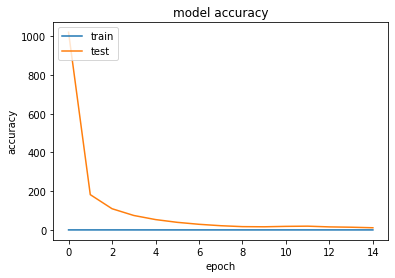

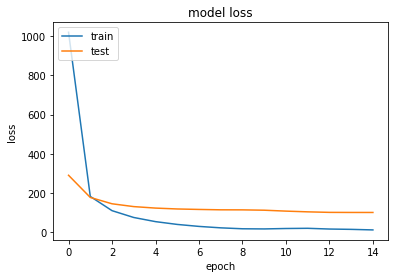

In [11]:
if train==True:
	model=load_weights(model,path_wts)
	model=train_model(model)
if train==False:
	model.load_weights(path_wts_final)

### Predicion Block

90 131 116 201
(0.2710601916679969, 0.26237121912149286, 0.3502359573657696, 0.40321789338038516, 0.67926264, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


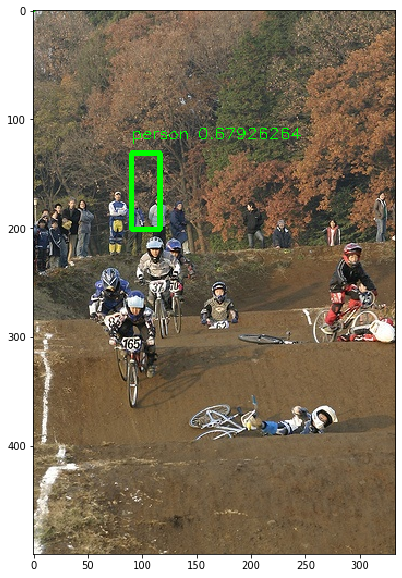

117199.87194592427
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


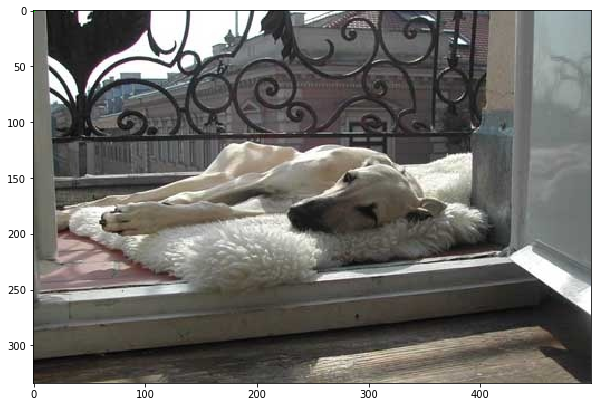

169851
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


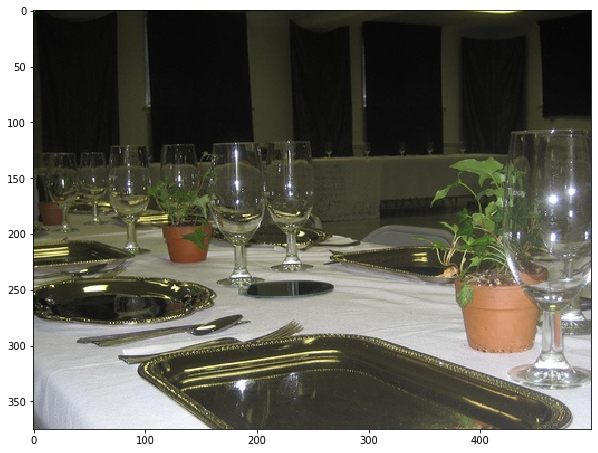

219627
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


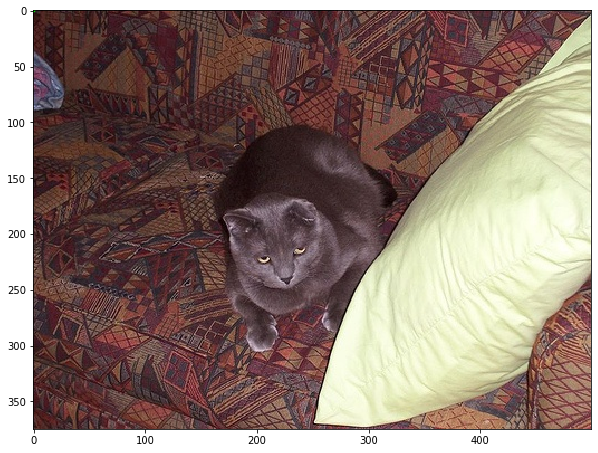

163091
85 200 180 327
(0.2569200075589694, 0.40095106454995966, 0.541251329275278, 0.6558817625045776, 0.7506583, 15)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


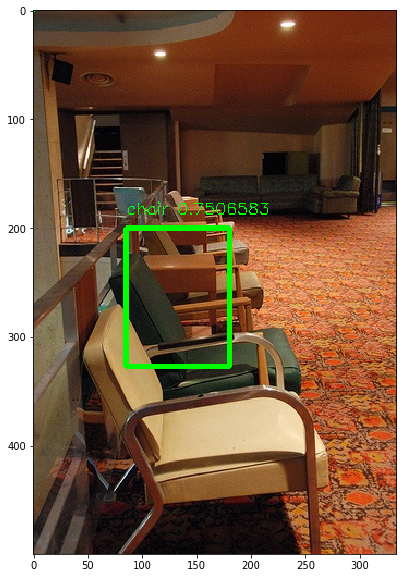

87746.3827977239
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


C:\Users\irfan\Anaconda3\envs\tf\lib\site-packages\ipykernel_launcher.py:12: RuntimeWarning: overflow encountered in exp
  if sys.path[0] == '':


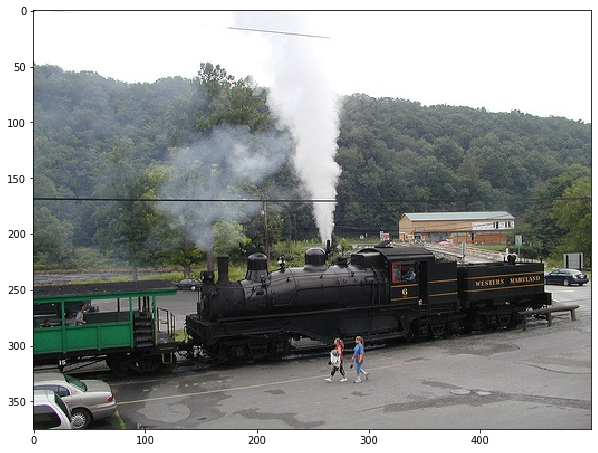

183955
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


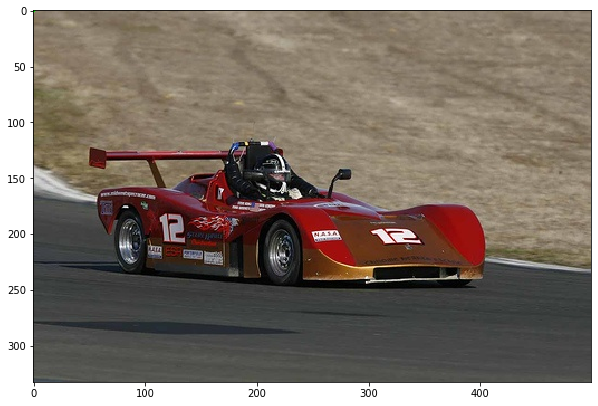

73038
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


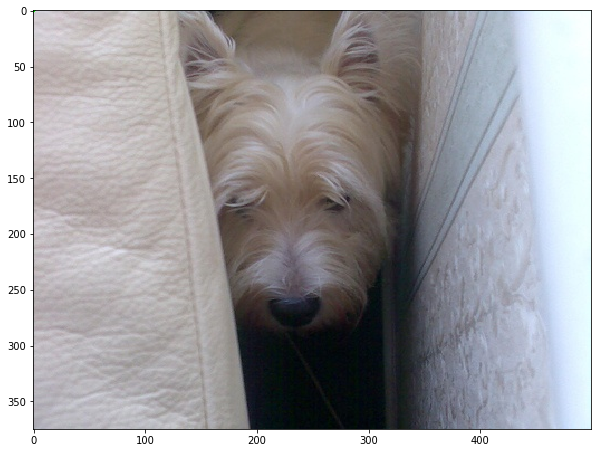

194115
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


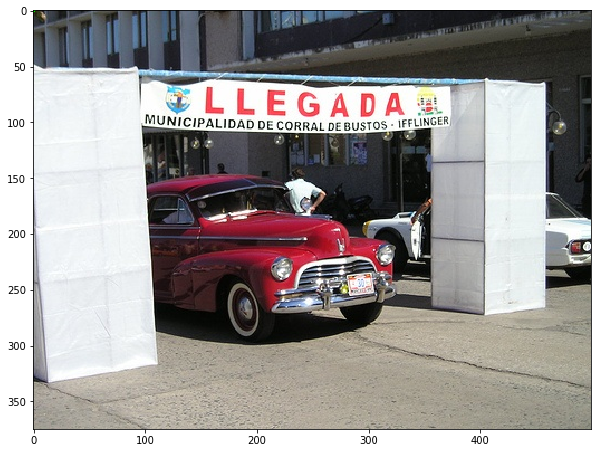

155375
188 57 379 311
(0.37686505684485805, 0.1714042883652907, 0.7591515687795786, 0.9346825159513035, 0.7783917, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


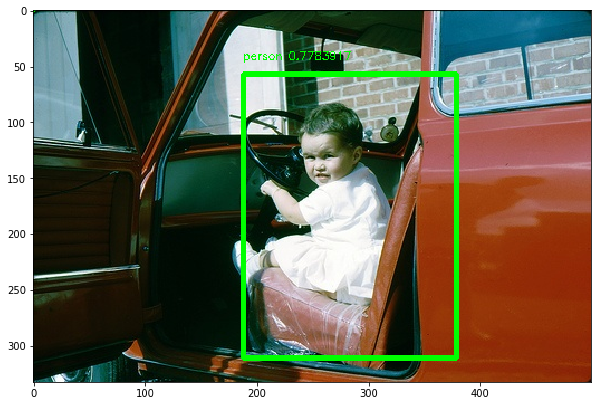

31782.53235682938
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


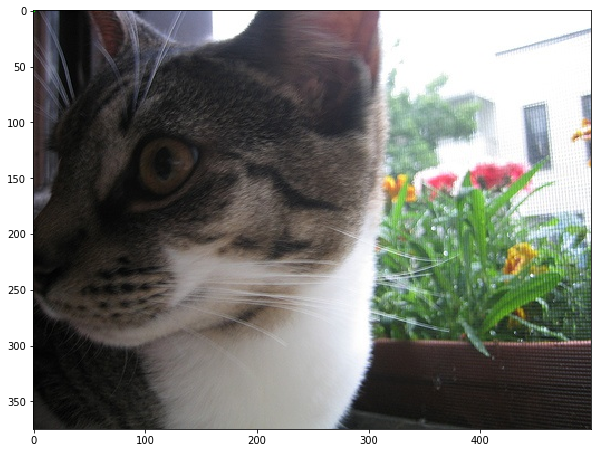

298231
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


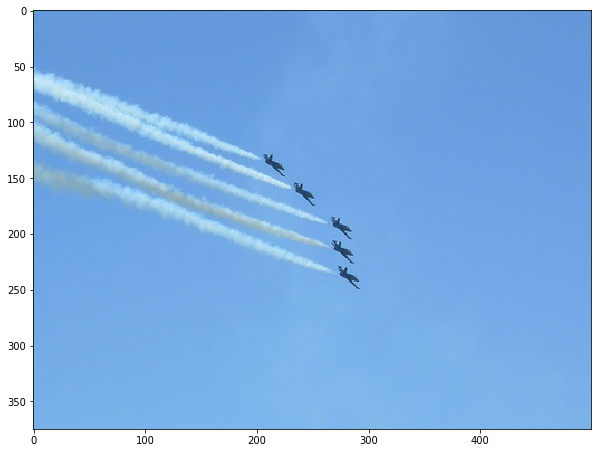

57003
448 31 472 71
(0.8977398299253904, 0.15421073253338152, 0.9459937375325423, 0.3554777915661152, 0.6535118, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


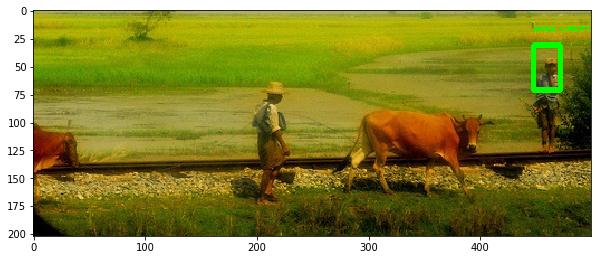

127595.2461232194
164 196 251 254
(0.3288591366547805, 0.5970494196965145, 0.5021227781589215, 0.7730596982515775, 0.78644574, 9)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


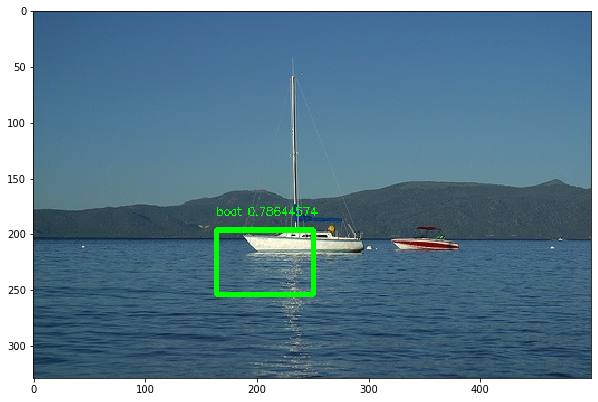

34288.38536726011
92 109 252 342
(0.1858925635998066, 0.2931767610403208, 0.5051030929271991, 0.916250779078557, 0.7591752, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


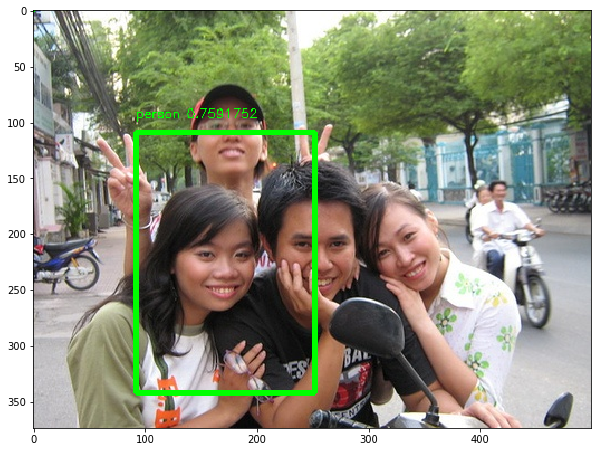

43936.74843842734
240 21 405 293
(0.4817853707533617, 0.057989780719463646, 0.8119202026954064, 0.783402809729943, 0.75145155, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


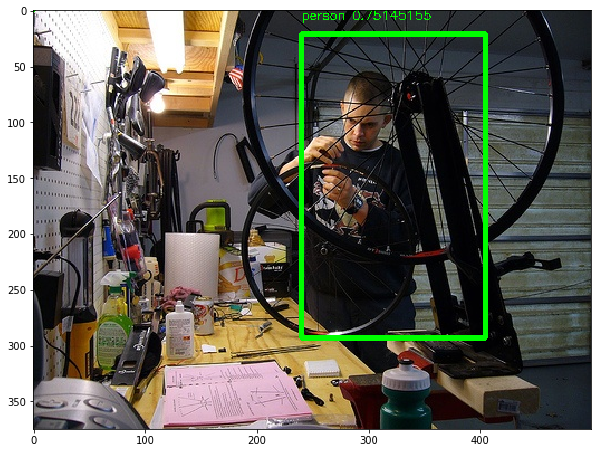

288589.24361208966
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


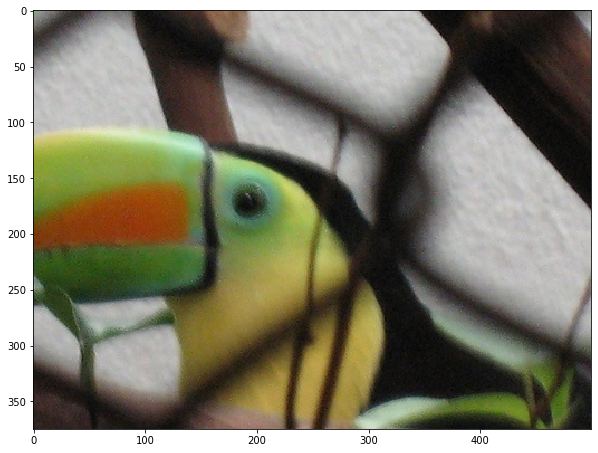

376530
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


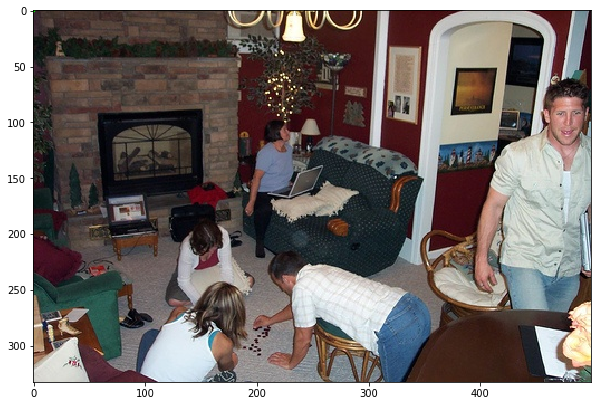

96259
99 83 425 351
(0.19930050923274117, 0.22280282240647536, 0.8503008989187388, 0.9361575933603141, 0.73212737, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


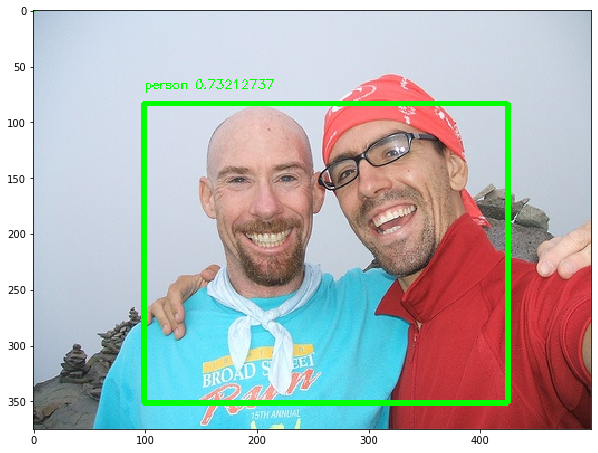

50420.77696131311
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


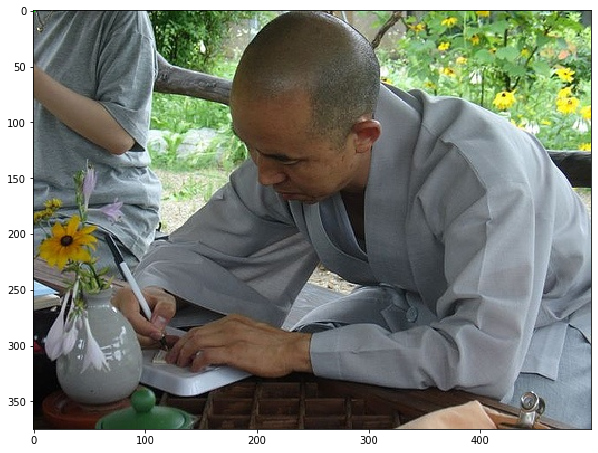

399796
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


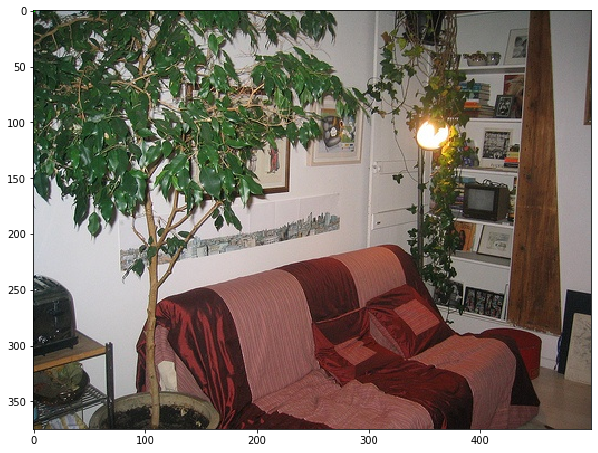

281653
63 9 74 59
(0.12724882364273074, 0.028137303315676168, 0.149013679761153, 0.16714444068761974, 0.6448974, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


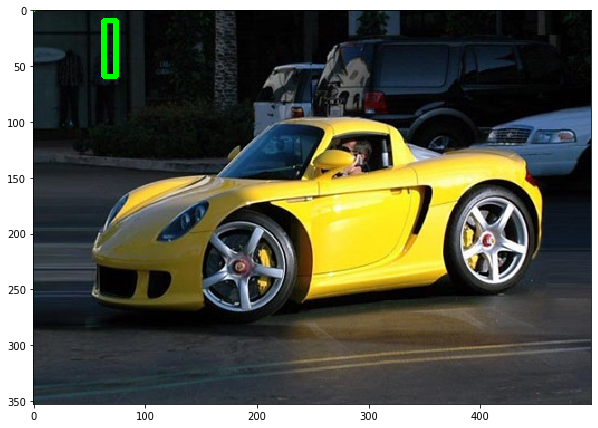

27789.297028714078
355 61 450 290
(0.7116162868646475, 0.1855472784775954, 0.9012236320055448, 0.8737898973318248, 0.7733216, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


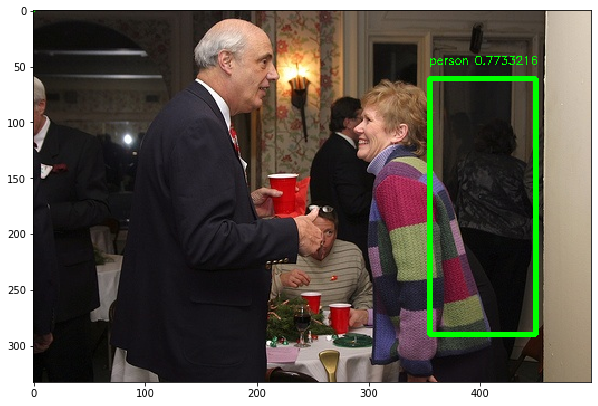

94284.76060353036
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


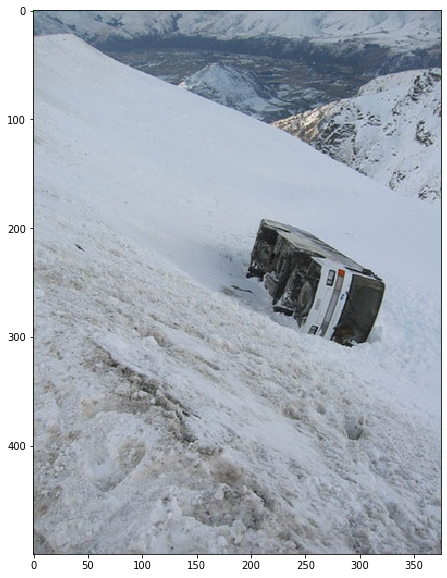

156548
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


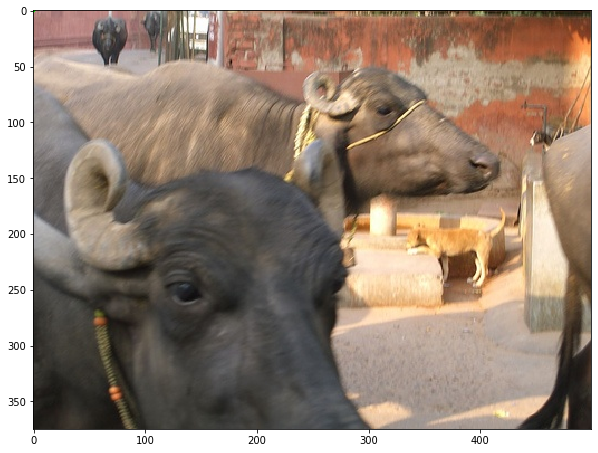

316085
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


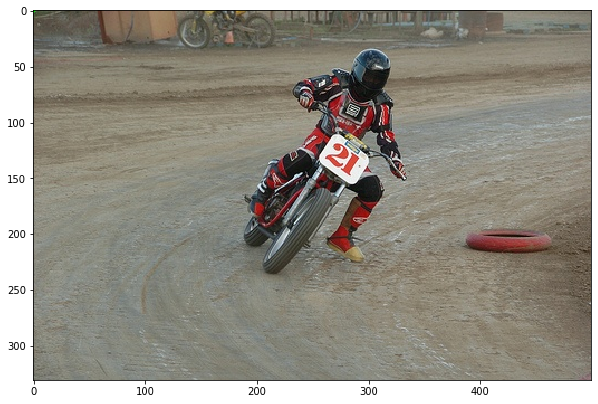

140816
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


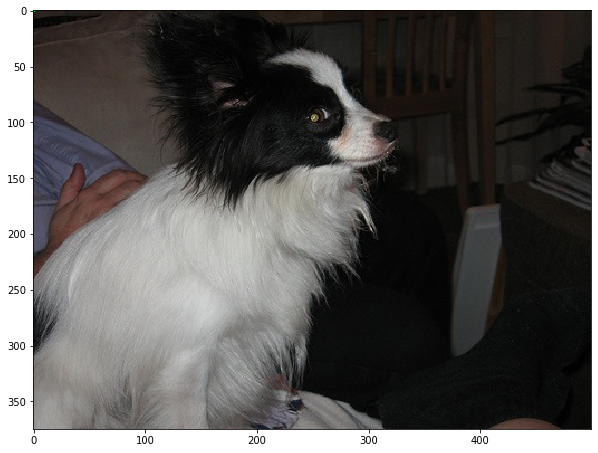

305218
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


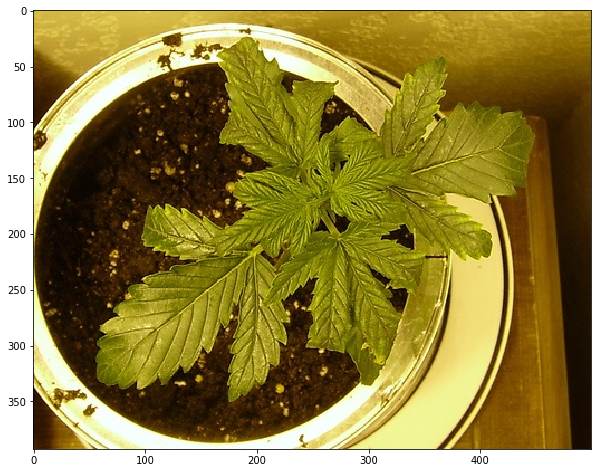

370895
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


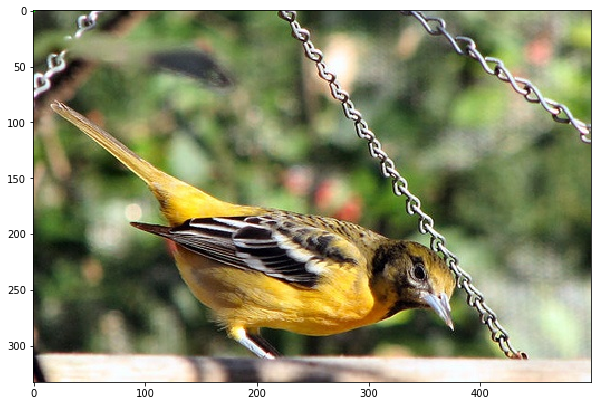

260855
175 59 281 257
(0.3650089685733502, 0.18693326069758487, 0.5874149340849657, 0.8104988611661471, 0.7300794, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


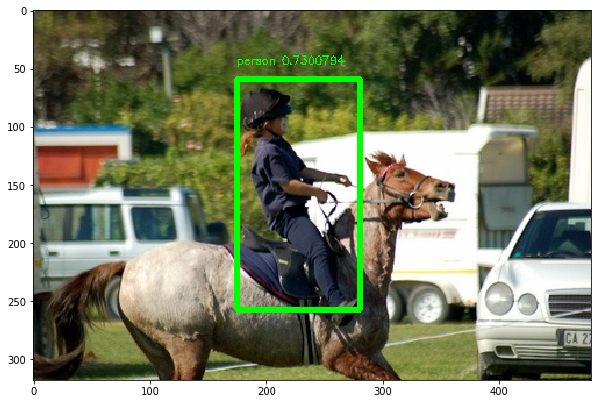

53953.65560077879
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


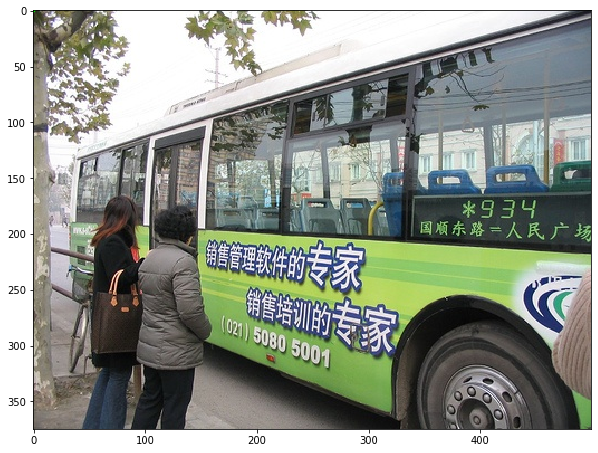

414302
189 78 387 268
(0.3795223786280705, 0.20988401999840373, 0.7743550997513992, 0.7165599602919359, 0.6362271, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


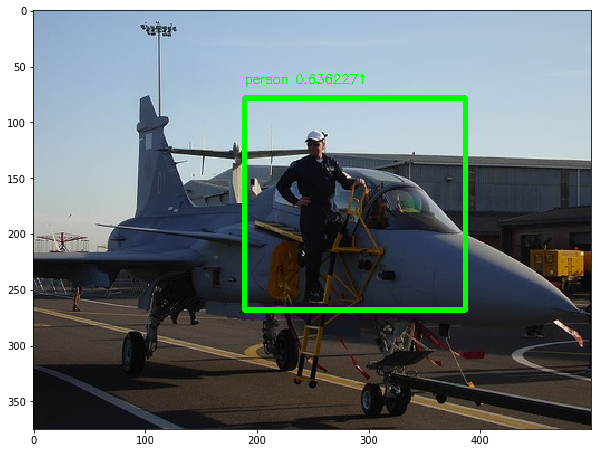

33826.44496434007
116 143 242 330
(0.23209886367504418, 0.3824246663313645, 0.4848212553904607, 0.8826285692361685, 0.766927, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


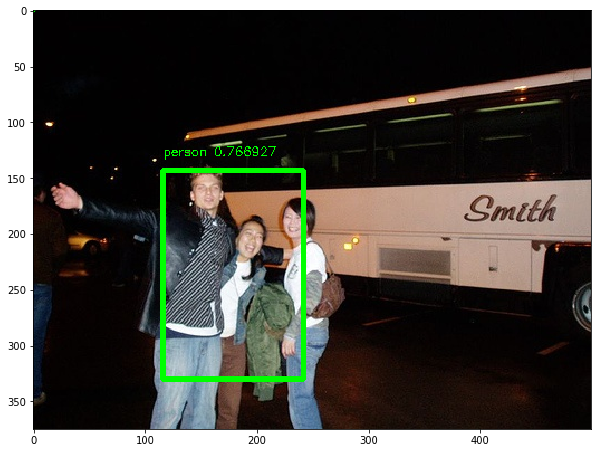

48902.85751567376
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


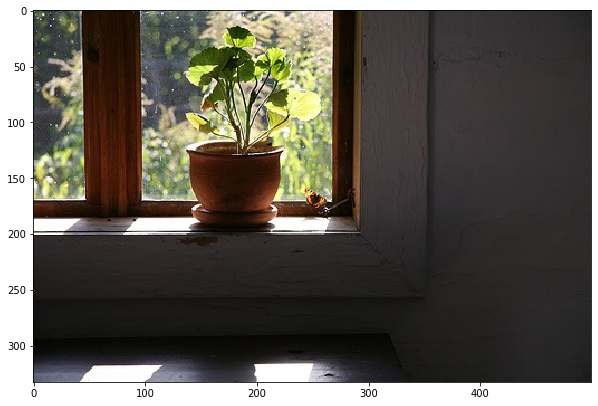

105154
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


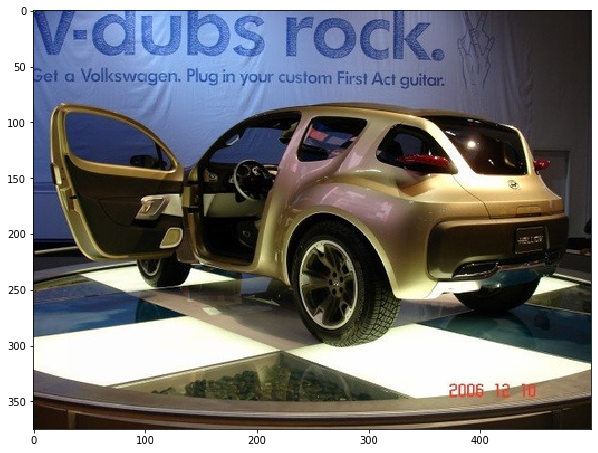

299564
103 133 364 292
(0.20712494850158691, 0.40229122455303484, 0.7283505476438082, 0.8780623215895433, 0.7590334, 1)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


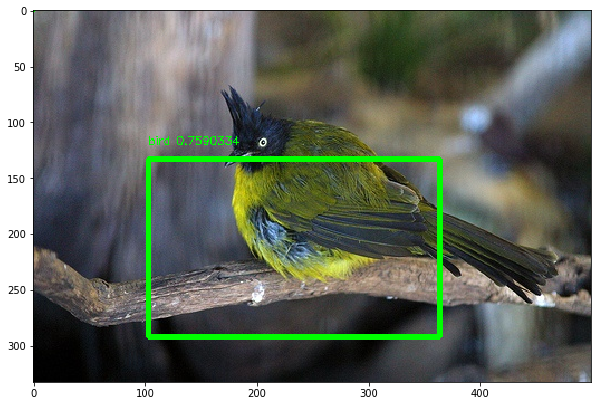

49788.05785366951
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


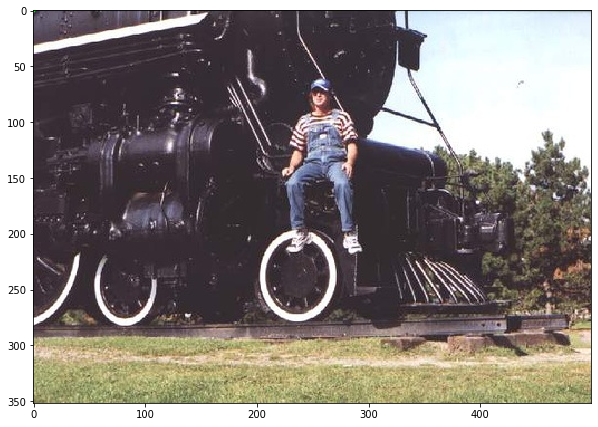

298200
59 159 112 236
(0.11919628656827488, 0.4796917713605441, 0.2259514698615441, 0.7094180308855497, 0.725611, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


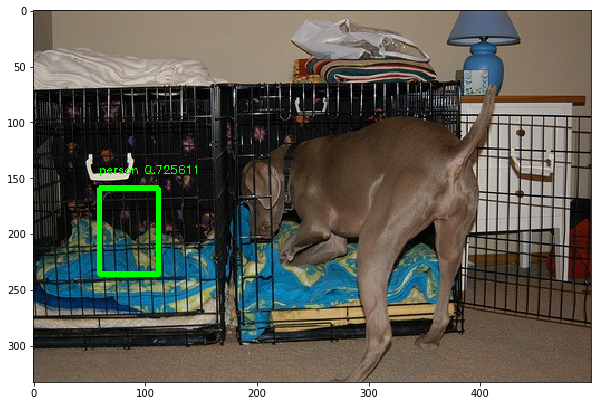

54740.120024224656
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


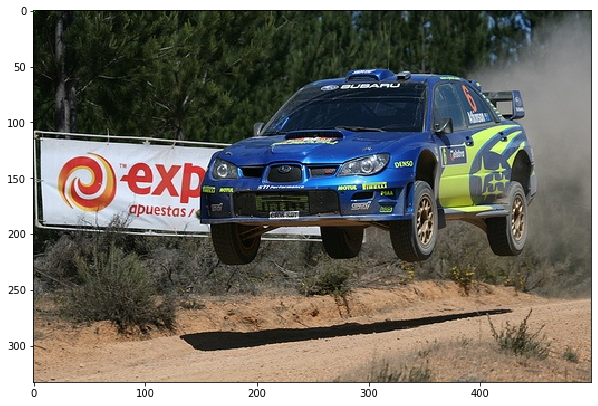

215395
52 124 121 184
(0.1051172705797049, 0.31214293149801403, 0.242789245568789, 0.46357399683732253, 0.7639604, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


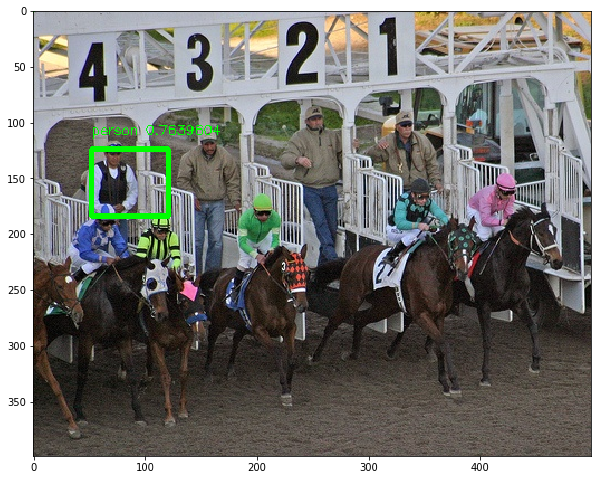

15380.545134580383
112 55 239 247
(0.2242055581166194, 0.148612902714656, 0.4794223950459407, 0.6592763020442083, 0.72705954, 0)
134 197 143 256
(0.2698817614179391, 0.5261765535061177, 0.28709048548570043, 0.684049652172969, 0.6399953, 14)
0 0 0 0
(0, 0, 0, 0, 0, 0)


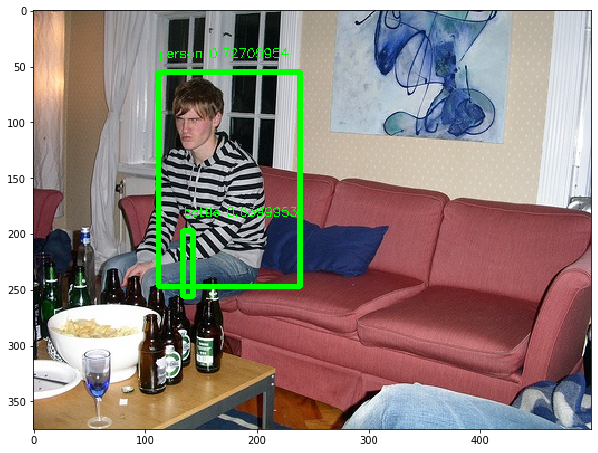

92139.14141712038
44 42 245 268
(0.15214909040010893, 0.14596630976750302, 0.8406935104956994, 0.9325357583852916, 0.7088558, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


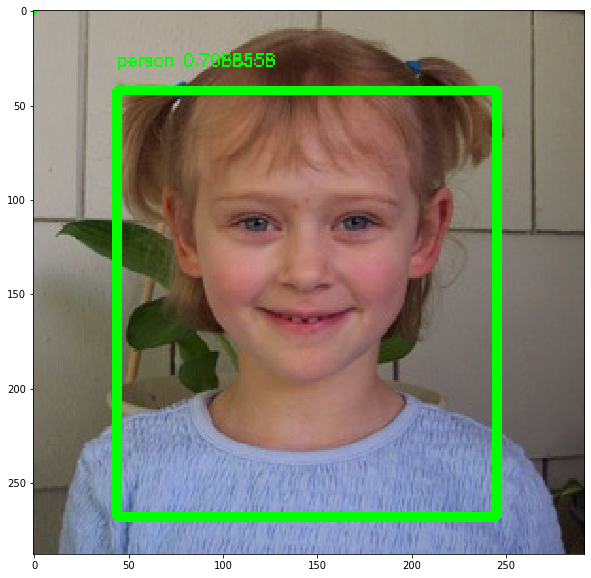

96990.54064456982
278 210 405 255
(0.5574594185902523, 0.6263437867164612, 0.8106477168890146, 0.7611725284503057, 0.7284674, 11)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


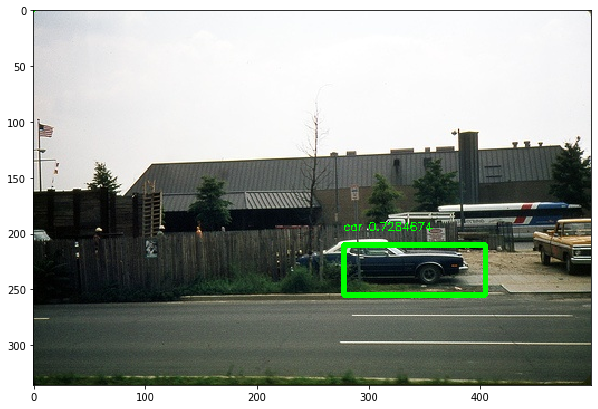

144280.03253943505
69 75 117 167
(0.19994072730724627, 0.2883840524233305, 0.33604140465076154, 0.6395861002115104, 0.752412, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


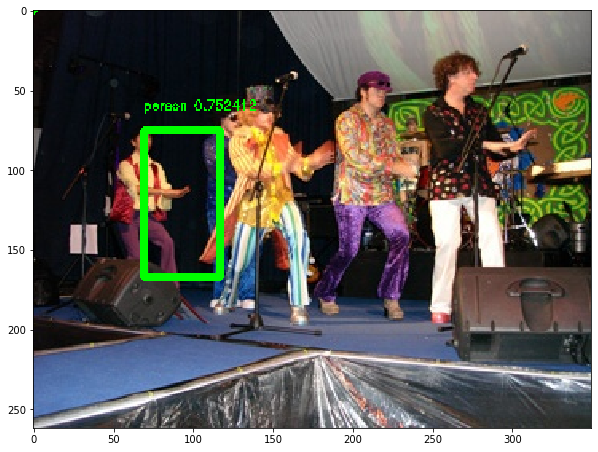

23251.133758306423
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


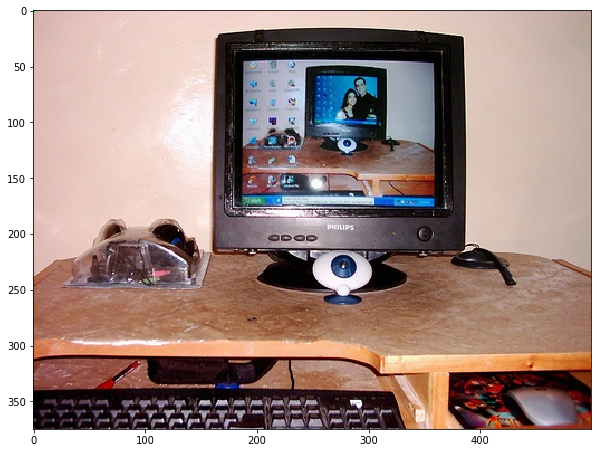

182647
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


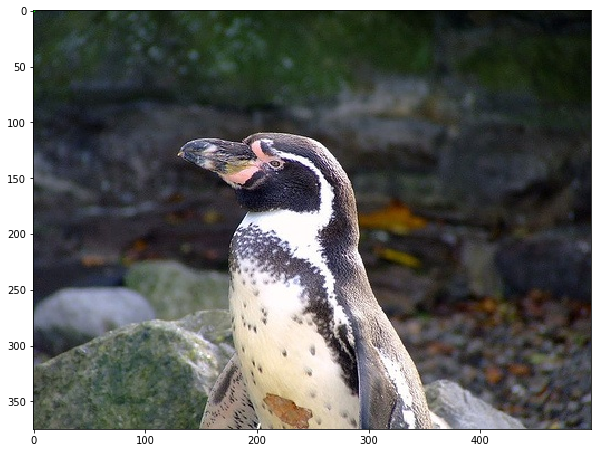

234763
74 12 199 476
(0.30478644371032715, 0.02423422153179461, 0.8175104031196008, 0.9524389046889086, 0.7482889, 0)
112 224 218 447
(0.459224114051232, 0.44884254382206845, 0.8965195875901443, 0.8942696681389442, 0.73001957, 1)
0 0 0 0
(0, 0, 0, 0, 0, 0)


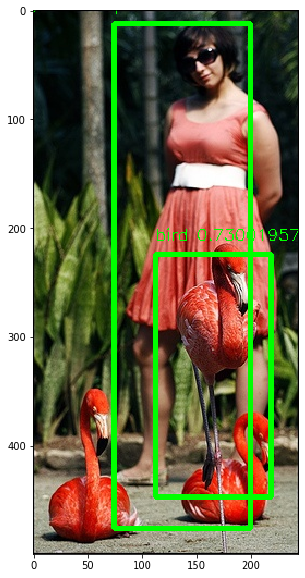

228259.9500983
74 141 335 239
(0.14927953940171462, 0.426202654838562, 0.6716936368208666, 0.7178996617977436, 0.7232434, 11)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


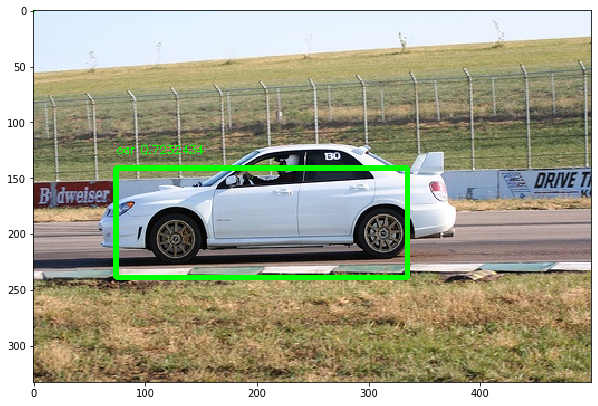

44097.84269854208
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


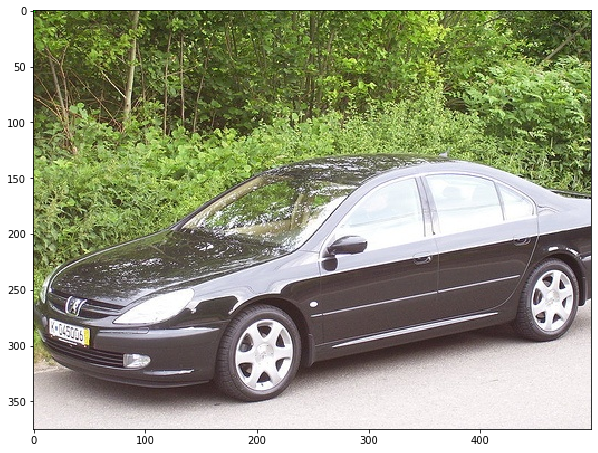

345746
mean error 100.0


In [42]:
def _softmax(x, axis=-1, t=-100.):
    x = x - np.max(x)
    
    if np.min(x) < t:
        x = x/np.min(x)*t
        
    e_x = np.exp(x)
    
    return e_x / e_x.sum(axis, keepdims=True)

def _sigmoid(x):
    return 1. / (1. + np.exp(-x))

def decode_netout_anc(netout, anchors, nb_class, obj_threshold=0.3, nms_threshold=0.3):
    #grid_h, grid_w, nb_box = netout.shape[:3]
    grid_h, grid_w = netout.shape[:2]

    boxes = []
    
    # decode the output by the network
    netout[..., 4]  = _sigmoid(netout[..., 4])
    netout[..., 5:] = netout[..., 4][..., np.newaxis] * _softmax(netout[..., 5:])
    netout[..., 5:] *= netout[..., 5:] > obj_threshold
    
    for row in range(grid_h):
        for col in range(grid_w):
            for b in range(BOX):
                # from 4th element onwards are confidence and class classes
                classes = netout[row,col,b,5:]
                #classes = netout[row,col,5:]
                confidence = netout[row,col,b,4]
                if np.sum(classes) > 0:
                    # first 4 elements are x, y, w, and h
                    #x, y, w, h = netout[row,col,b,:4]
                    x, y, w, h = netout[row,col,b,:4]
                    #print(col,_sigmoid(x-col),row,_sigmoid(y),w,h)
                    x = (col + _sigmoid(x)) / grid_w # center position, unit: image width
                    y = (row + _sigmoid(y)) / grid_h # center position, unit: image height
                    w = ANCHORS[2 * b + 0] * np.exp(w) / grid_w # unit: image width
                    h = ANCHORS[2 * b + 1] * np.exp(h) / grid_h # unit: image height
                    #print(x,y,w,h)
                    classes=np.argmax(classes)
                    
                    box = (x-w/2, y-h/2, x+w/2, y+h/2, confidence, classes)
                    box = (x-w/2, y-h/2, x+w/2, y+h/2, confidence, classes)
                    if abs(box[0])<=1 and abs(box[1])<=1 and box[2]<=1 and box[3]<=1 :
                      if (box[0])>=0 and (box[1])>=0 and box[2]>=0 and box[3]>=0 :
                        boxes.append(box)
                    

                      
    indx=np.argsort([box[4] for box in boxes])
    f_boxes=[]
    #indx=reversed(indx)
    if len(indx)>=3:
      for i in range(1,2):
        ind=indx[-1*i]
        f_boxes.append(boxes[ind])
    else:
      f_boxes=boxes
    return f_boxes    
    
def decode_netout_1(netout, anchors, nb_class, obj_threshold=0.3, nms_threshold=0.3):
    #grid_h, grid_w, nb_box = netout.shape[:3]
    grid_h, grid_w = netout.shape[:2]

    boxes = []
    
    # decode the output by the network
    netout[..., 4]  = _sigmoid(netout[..., 4])
    netout[..., 5:] = netout[..., 4][..., np.newaxis] * _softmax(netout[..., 5:])
    netout[..., 5:] *= netout[..., 5:] > obj_threshold
    class_prob_log=[0]*CLASS
    boxes=[(0,)*6]*CLASS
    for row in range(grid_h):
        for col in range(grid_w):
            #for b in range(BOX):
                # from 4th element onwards are confidence and class classes
                classes = netout[row,col,5:]
                #classes = netout[row,col,5:]
                confidence = netout[row,col,4]
                if np.sum(classes) > 0:
                    # first 4 elements are x, y, w, and h
                    #x, y, w, h = netout[row,col,b,:4]
                    x, y, w, h = netout[row,col,:4]
                    #print(col,_sigmoid(x-col),row,_sigmoid(y),w,h)
                    x = x*(32/416) # center position, unit: image width
                    y = y*(32/416) # center position, unit: image height
                    w = w*(32/416) # unit: image width
                    h = h*(32/416) # unit: image height
                    #print(x,y,w,h)
                    class_ind=np.argmax(classes)
                    if class_prob_log[class_ind]< classes[class_ind]:       
                        class_prob_log[class_ind]=classes[class_ind]
                        box = (x-w/2, y-h/2, x+w/2, y+h/2, confidence, class_ind)
                        if abs(box[0])<=1 and abs(box[1])<=1 and box[2]<=1 and box[3]<=1 :
                              if (box[0])>=0 and (box[1])>=0 and box[2]>=0 and box[3]>=0 :
                                                    #boxes.append(box)
                                                    boxes[class_ind]=box

                      
    
    indx=np.argsort([box[4] for box in boxes])
    # remove the boxes which are less likely than a obj_threshold
    #obj_threshold=0
    #print(boxes)
    #for box in boxes:
    #  if box[4]>obj_threshold:
    #      obj_threshold=box[4]
    #boxes = [box for box in boxes if box[4] >= obj_threshold-0.1]
    f_boxes=[]
    #indx=reversed(indx)
    if len(indx)>=3:
      for i in range(1,4):
        ind=indx[-1*i]
        f_boxes.append(boxes[ind])
    else:
      f_boxes=boxes

    return f_boxes    

def draw_boxes_1(image, boxes, labels,t_lbl=None):
    image_h, image_w, _ = image.shape

    for box in boxes:
        xmin = int(box[0]*image_w)
        ymin = int(box[1]*image_h)
        xmax = int(box[2]*image_w)
        ymax = int(box[3]*image_h)
        x_off=20
        y_off=20
        print(xmin,ymin,xmax,ymax)
        print(box)
        #cv2.rectangle(image, (xmin-x_off,ymin-y_off), (xmax+x_off,ymax+y_off), (255,0,0), 3)
        cv2.rectangle(image, (xmin,ymin), (xmax,ymax), (0,255,0), 3)
        #if t_lbl !=None:
        #  cv2.rectangle(image, (t_lbl[0],t_lbl[1]), (t_lbl[2],t_lbl[3]), (0,0,255), 3)
        cv2.putText(image, 
                    labels[box[5]] + ' ' + str(box[4]), 
                    (xmin, ymin - 13), 
                    cv2.FONT_HERSHEY_SIMPLEX, 
                    1e-3 * image_h, 
                    (0,255,0), 1)
        
    return image

"""# Perform detection on image"""
error=0
count=0
import pandas as pd
#lbls=pd.read_csv(path_data+'/label.csv',names=[0,1,2,3,4,5])
  
for i in range(1,50):
  count+=1
  sample=valid_imgs[i]
  image = cv2.imread(sample['filename'])
  H_off=int(image.shape[0]*0.1)
  W_off=int(image.shape[1]*0.1)
  #image=image[H_off:-1*H_off,W_off:-1*W_off,:]
  dummy_array = np.zeros((1,1,1,1,TRUE_BOX_BUFFER,4))

  

  input_image = cv2.resize(image, (416, 416))
  input_image = input_image / 255.
  input_image = input_image[:,:,::-1]
  input_image = np.expand_dims(input_image, 0)

  netout = model.predict(input_image)
  #print(netout[0,:,:,0:2])


  if anc_box==True:
    boxes = decode_netout_anc(netout[0], 
                        obj_threshold=.60,
                        nms_threshold=.90,
                        anchors=ANCHORS, 
                        nb_class=CLASS)
  else:
    boxes = decode_netout_1(netout[0], 
                        obj_threshold=0.60,
                        nms_threshold=0.9,
                        anchors=ANCHORS, 
                        nb_class=CLASS)
  lbl=sample['object'][0]
  [xmin,ymin,xmax,ymax]=list(lbl.values())[1:]
  cx,cy=int(0.5*(xmax+xmin)),int(0.5*(ymax+ymin))
  iw,ih=int(xmax-xmin),int(ymax-ymin)
  true_lb=[cx,cy,iw,ih]
  err=np.sum(np.square(np.array(true_lb)-np.array(boxes[0][:4])*416))
  if err<100:
    error+=err
  else:
    error+=100
  #boxex.appned(true_lb)
  image = draw_boxes_1(image, boxes, LABELS,true_lb)
  plt.figure(figsize=(10,10))
  plt.imshow(image[:,:,::-1]); plt.show()
  print(err)
print('mean error',error/count)

In [13]:
boxes

[(0.07753988412710333,
  0.3830864979670598,
  0.9865829761211689,
  0.9377638743473933,
  0.7280262,
  11),
 (0.044300702901986955,
  0.3144306953136738,
  0.7698539953965408,
  0.719664922127357,
  0.7253168,
  0),
 (0.10689441974346453,
  0.3830687082730807,
  0.8912670428936298,
  0.8930713580204891,
  0.7036552,
  11)]

In [14]:
[cx,cy,iw,ih]

[210, 265, 411, 250]

In [15]:
model.save('yolo_400.h5')

In [16]:
import pandas as pd
lbls=pd.read_csv(path_data+'/label.csv',names=[0,1,2,3,4,5])
true_lb=list(lbls.loc[0,0:5])
true_lb

NameError: name 'path_data' is not defined

In [17]:
import numpy as np
import tensorflow as tf
label=np.ones((7,7,15))
label[...,14]=5
true_box=np.argmax(label[...,10:],-1)

In [18]:
wts=np.ones((10))
wts[3:7]=9
res=tf.gather(wts,true_box)
sess=tf.Session()
ret=sess.run(res)
ret

array([[9., 9., 9., 9., 9., 9., 9.],
       [9., 9., 9., 9., 9., 9., 9.],
       [9., 9., 9., 9., 9., 9., 9.],
       [9., 9., 9., 9., 9., 9., 9.],
       [9., 9., 9., 9., 9., 9., 9.],
       [9., 9., 9., 9., 9., 9., 9.],
       [9., 9., 9., 9., 9., 9., 9.]])

In [19]:
ret.shape

(7, 7)

In [35]:
label[...,4:].shape

(7, 7, 11)

In [34]:
label[...,5:].shape

(7, 7, 2, 15)

In [32]:
label[...,5:].shape

(7, 7, 10)